# Start to end test

In [1]:
# Specify device
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0"


Before runing this test, please download models from [https://nomeroff.net.ua/models/](https://nomeroff.net.ua/models/) to **./models/** directory. 

In [2]:
# Import all necessary libraries.
import sys
import cv2
import numpy as np
import matplotlib.pyplot as plt
from termcolor import colored

plt.rcParams["figure.figsize"] = (10,10)

In [3]:
# NomeroffNet path
NOMEROFF_NET_DIR = os.path.abspath('../')
sys.path.append(NOMEROFF_NET_DIR)

In [4]:
from NomeroffNet.BBoxNpPoints import NpPointsCraft, getCvZoneRGB, convertCvZonesRGBtoBGR, reshapePoints
npPointsCraft = NpPointsCraft()
npPointsCraft.load()

Loading weights from checkpoint (/mnt/store/nomeroff-net/nomeroff-net/NomeroffNet/tools/../../data/./models/NpPointsCraft/craft_mlt/craft_mlt_25k_2020-02-16.pth)
Loading weights of refiner from checkpoint (/mnt/store/nomeroff-net/nomeroff-net/NomeroffNet/tools/../../data/./models/NpPointsCraft/craft_refiner/craft_refiner_CTW1500_2020-02-16.pth)


In [5]:
from NomeroffNet.YoloV5Detector import Detector

detector = Detector()
detector.load()

/usr/local/lib64/python3.9/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)


In [6]:
from NomeroffNet.OptionsDetector import OptionsDetector

optionsDetector = OptionsDetector()
optionsDetector.load()

NPOptionsNet(
  (inp_conv): Conv2d(3, 32, kernel_size=(3, 3), stride=(1, 1))
  (conv1): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1))
  (conv2): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1))
  (conv3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1))
  (pool): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (dropout_reg): Dropout(p=0.2, inplace=False)
  (fc1_reg): Linear(in_features=4096, out_features=512, bias=True)
  (fc2_reg): Linear(in_features=512, out_features=256, bias=True)
  (batch_norm_reg): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc3_reg): Linear(in_features=256, out_features=15, bias=True)
  (dropout_line): Dropout(p=0.2, inplace=False)
  (fc1_line): Linear(in_features=4096, out_features=512, bias=True)
  (fc2_line): Linear(in_features=512, out_features=256, bias=True)
  (batch_norm_line): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc3_line): Linear(

In [7]:
from NomeroffNet.TextDetector import TextDetector
textDetector = TextDetector({
    "eu_ua_2004_2015": {
        "for_regions": ["eu_ua_2015", "eu_ua_2004"],
        "model_path": "latest"
    },
    "eu_ua_1995": {
        "for_regions": ["eu_ua_1995"],
        "model_path": "latest"
    },
    "eu": {
        "for_regions": ["eu"],
        "model_path": "latest"
    },
    "ru": {
        "for_regions": ["ru", "eu-ua-fake-lnr", "eu-ua-fake-dnr"],
        "model_path": "latest" 
    },
    "kz": {
        "for_regions": ["kz"],
        "model_path": "latest"
    },
    "ge": {
        "for_regions": ["ge"],
        "model_path": "latest"
    },
    "su": {
        "for_regions": ["su"],
        "model_path": "latest"
    }
})

In [8]:
from turbojpeg import TurboJPEG
jpeg = TurboJPEG()

async def test(dirName, fname, y, min_bbox_acc = 0.5, verbose=0):
    img_path = os.path.join(dirName, fname)
    if verbose==1:
        print(colored(f"__________ \t\t {img_path} \t\t __________", "blue"))
        
    with open(img_path, 'rb') as in_file:
        img = jpeg.decode(in_file.read())
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    targetBoxes = detector.detect_bbox(img)
    
    all_points = npPointsCraft.detect(img, targetBoxes,[3,1,0])
    # for  images/14.jpeg bug
    all_points = [ps for ps in all_points if len(ps)]
    
    # cut zones
    toShowZones = [getCvZoneRGB(img, reshapePoints(rect, 1)) for rect in all_points]
    zones = convertCvZonesRGBtoBGR(toShowZones)            

    # draw rect and 4 points
    for targetBox, points in zip(targetBoxes, all_points):
    #for targetBox in targetBoxes:
        # draw 
        cv2.rectangle(img, 
                      (int(targetBox[0]), int(targetBox[1])), 
                      (int(targetBox[2]), int(targetBox[3])), 
                      (0,120,255), 
                      3)
        #print(points, points.shape)
        cv2.polylines(img, np.array([points], np.int32), True, (255,120,255),3)
    plt.imshow(img)
    plt.show()

In [9]:
dirName = "./images"

0.jpeg
__________ 		 ./images/0.jpeg 		 __________


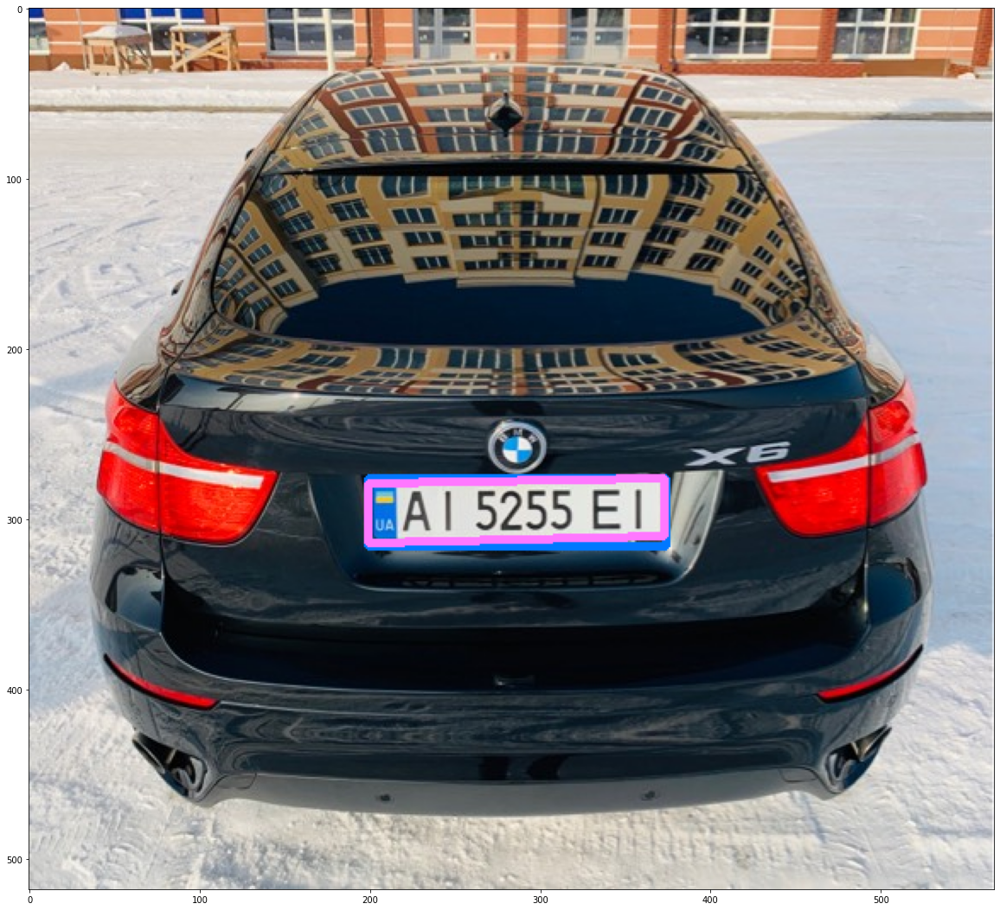

1.jpeg
__________ 		 ./images/1.jpeg 		 __________


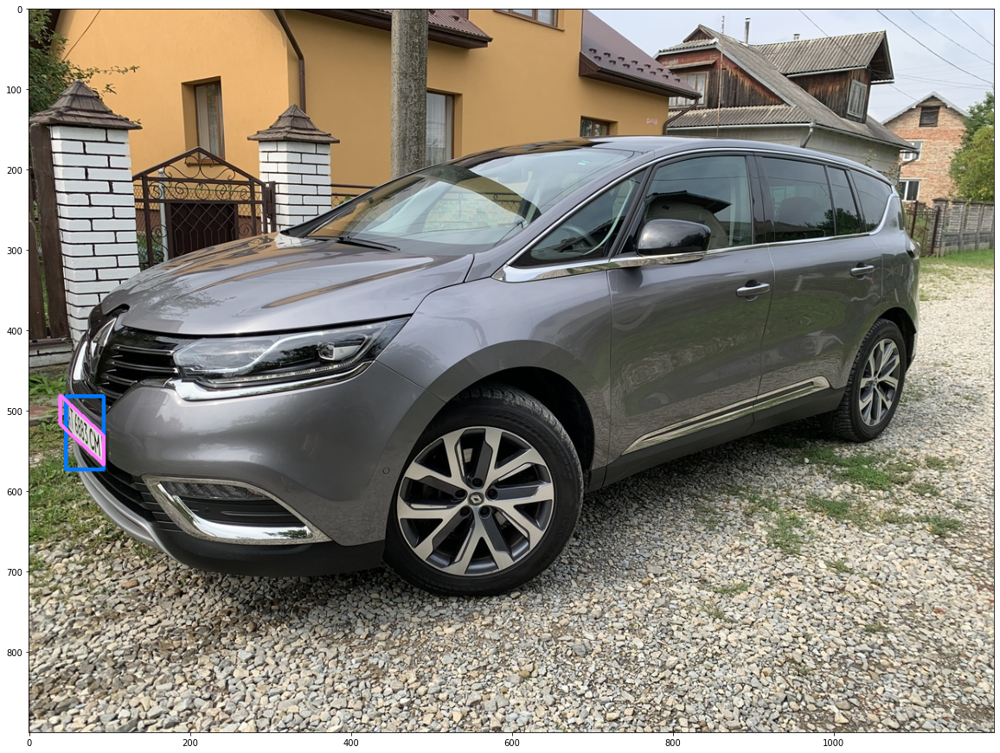

2.jpeg
__________ 		 ./images/2.jpeg 		 __________


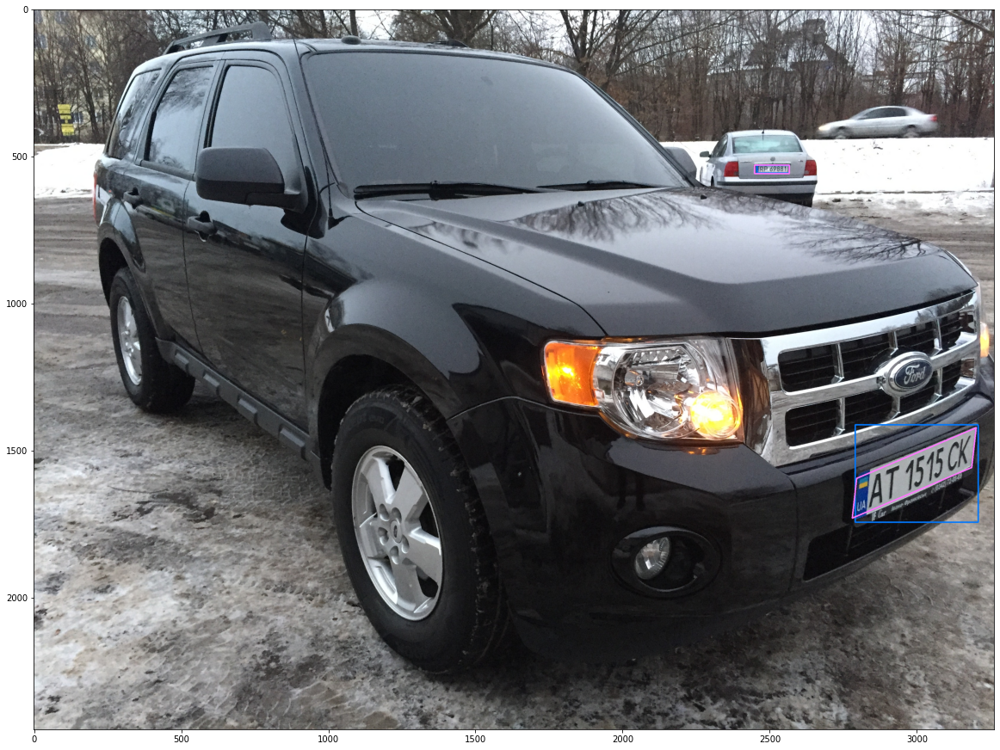

3.jpeg
__________ 		 ./images/3.jpeg 		 __________


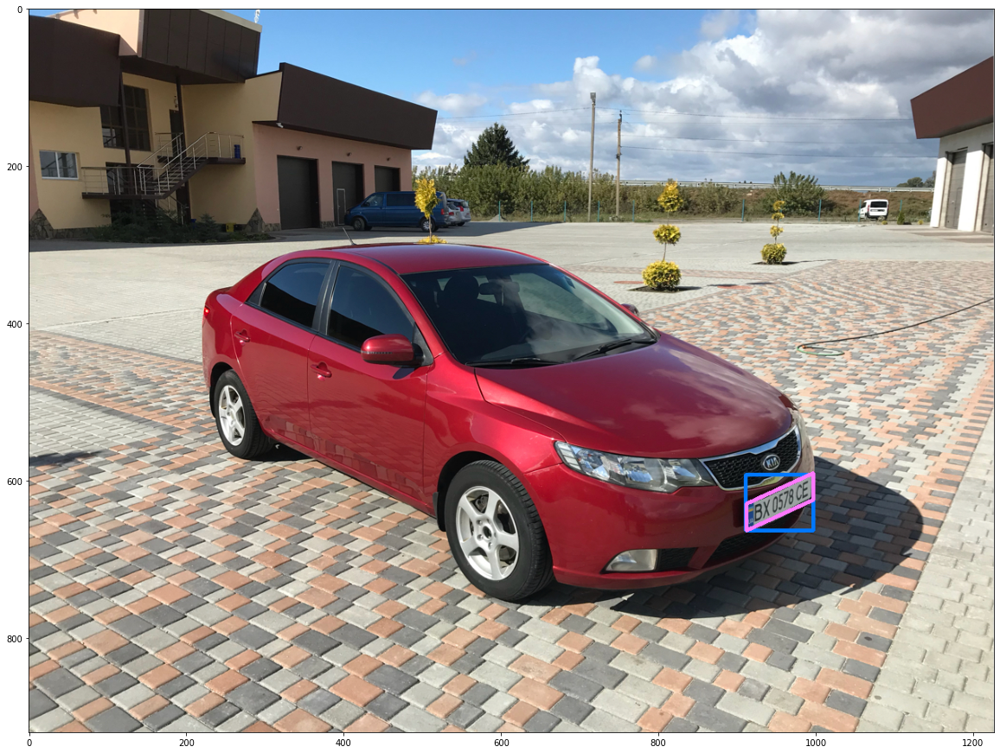

4.jpeg
__________ 		 ./images/4.jpeg 		 __________


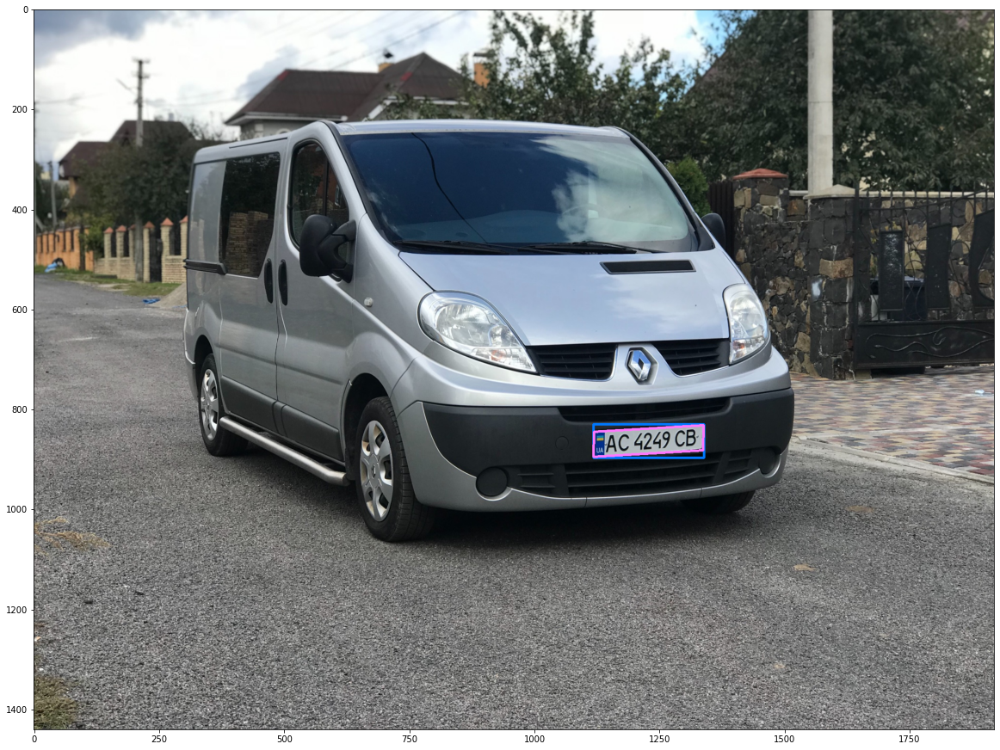

5.jpeg
__________ 		 ./images/5.jpeg 		 __________


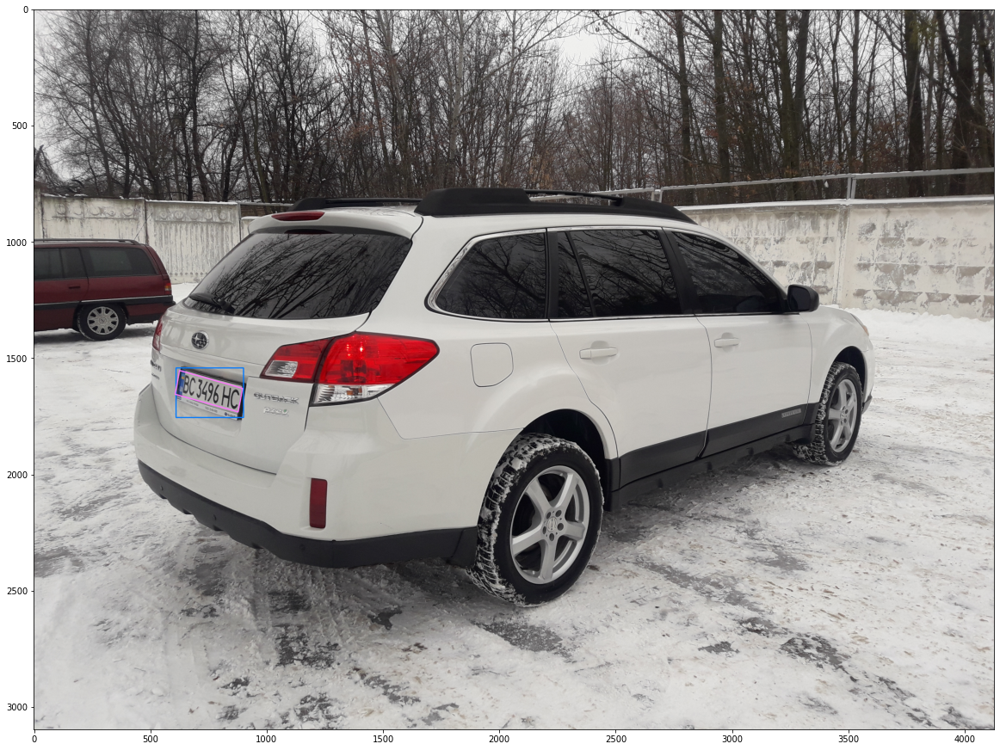

6.jpeg
__________ 		 ./images/6.jpeg 		 __________


/mnt/store/nomeroff-net/nomeroff-net/NomeroffNet/tools/../../data/./repos/NpPointsCraft/craft_mlt/craft_utils.py:239: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  polys = np.array(polys)


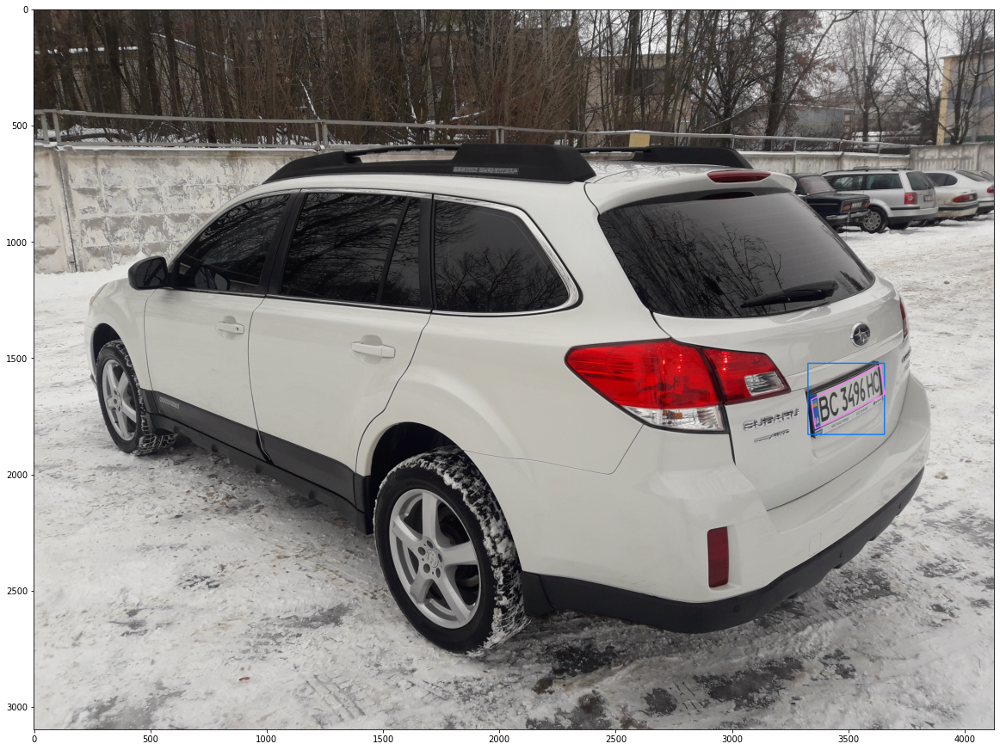

7.jpeg
__________ 		 ./images/7.jpeg 		 __________


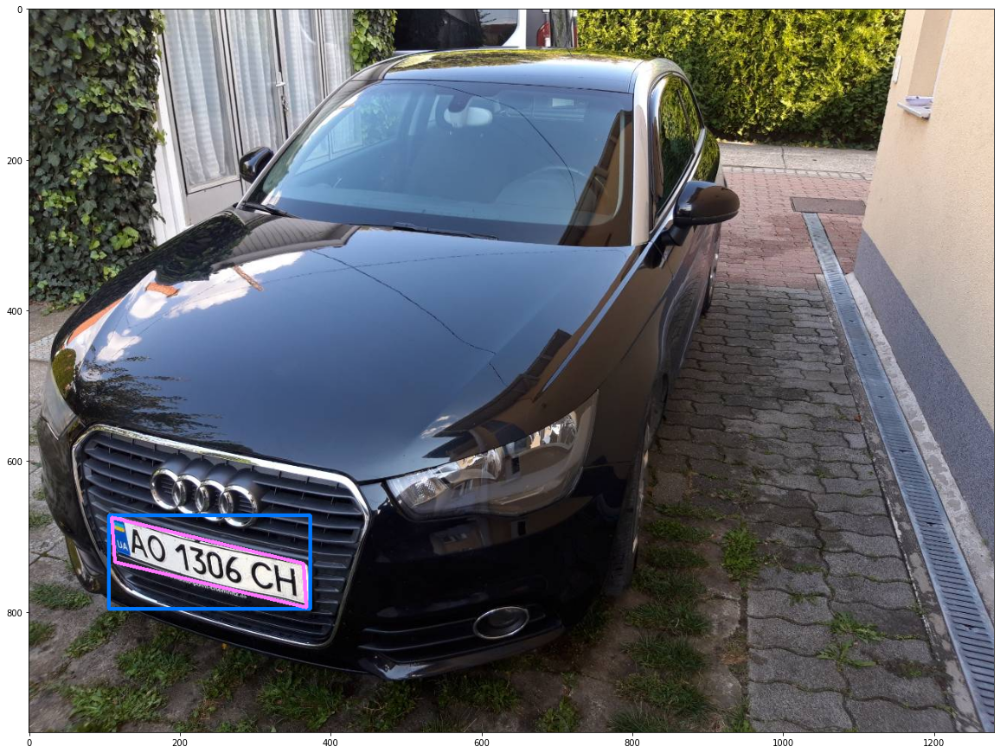

8.jpeg
__________ 		 ./images/8.jpeg 		 __________


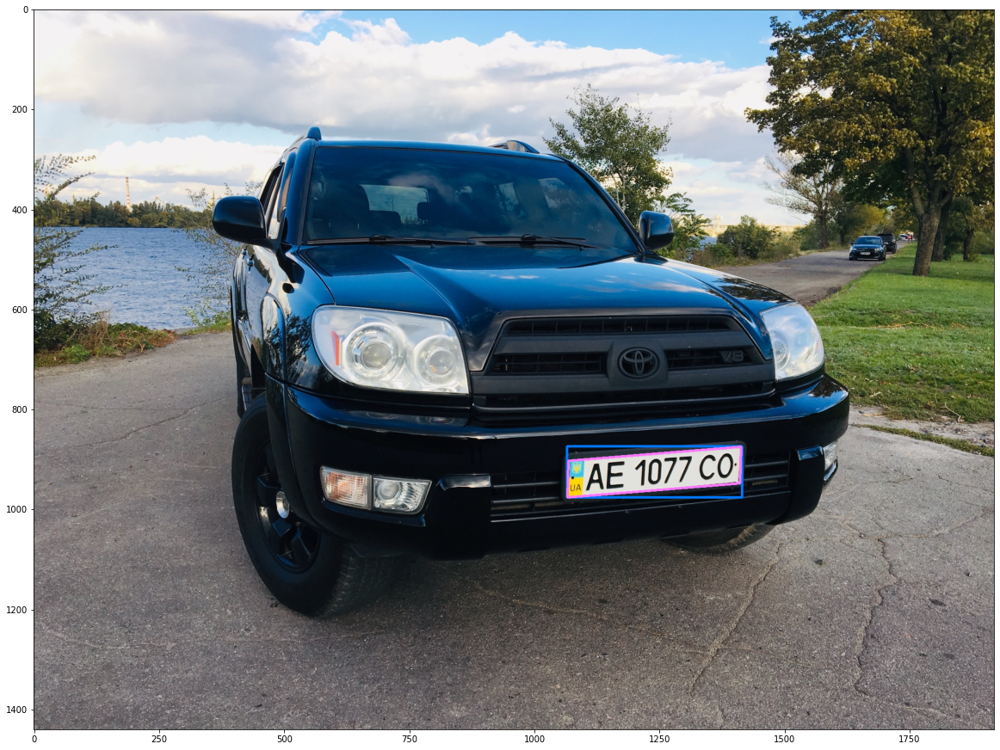

9.jpeg
__________ 		 ./images/9.jpeg 		 __________


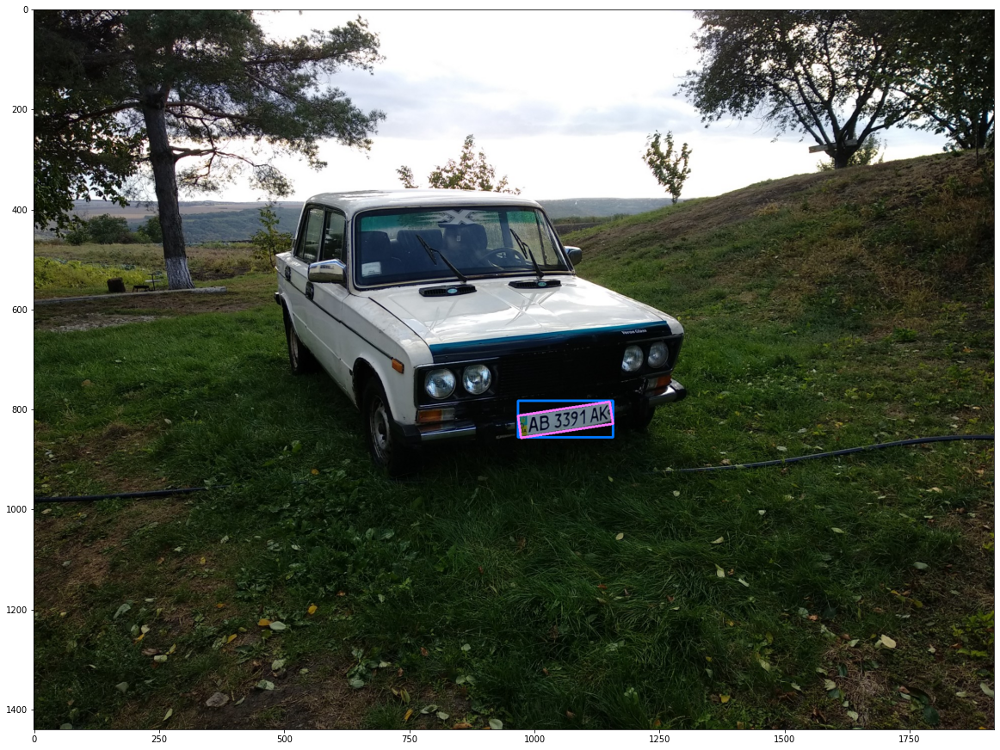

10.jpeg
__________ 		 ./images/10.jpeg 		 __________


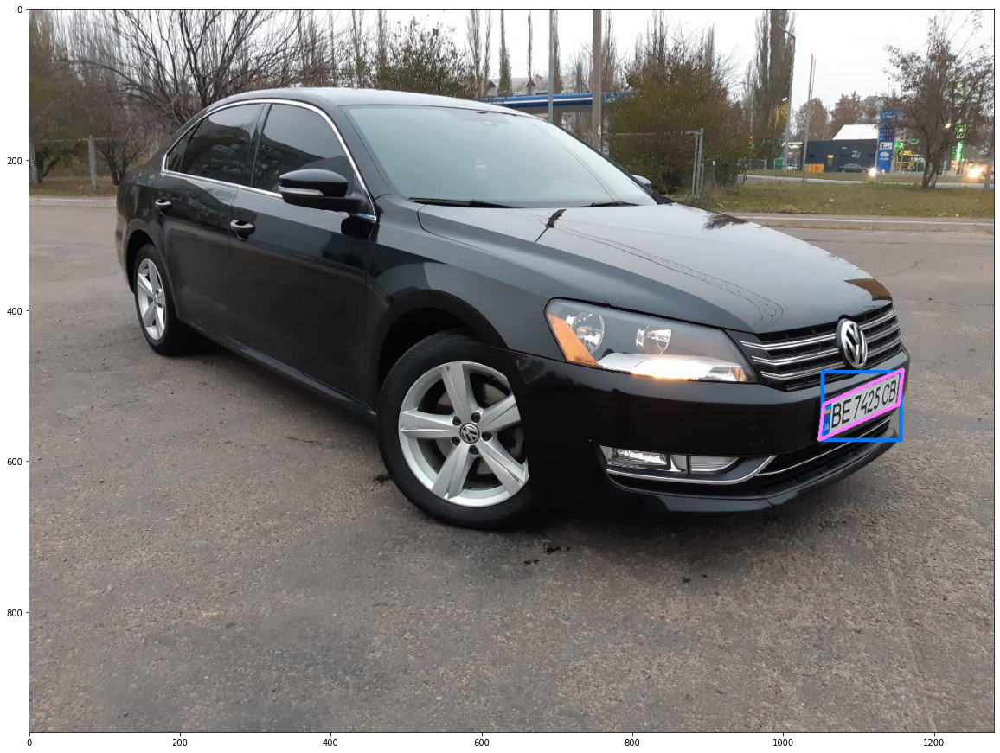

11.jpeg
__________ 		 ./images/11.jpeg 		 __________


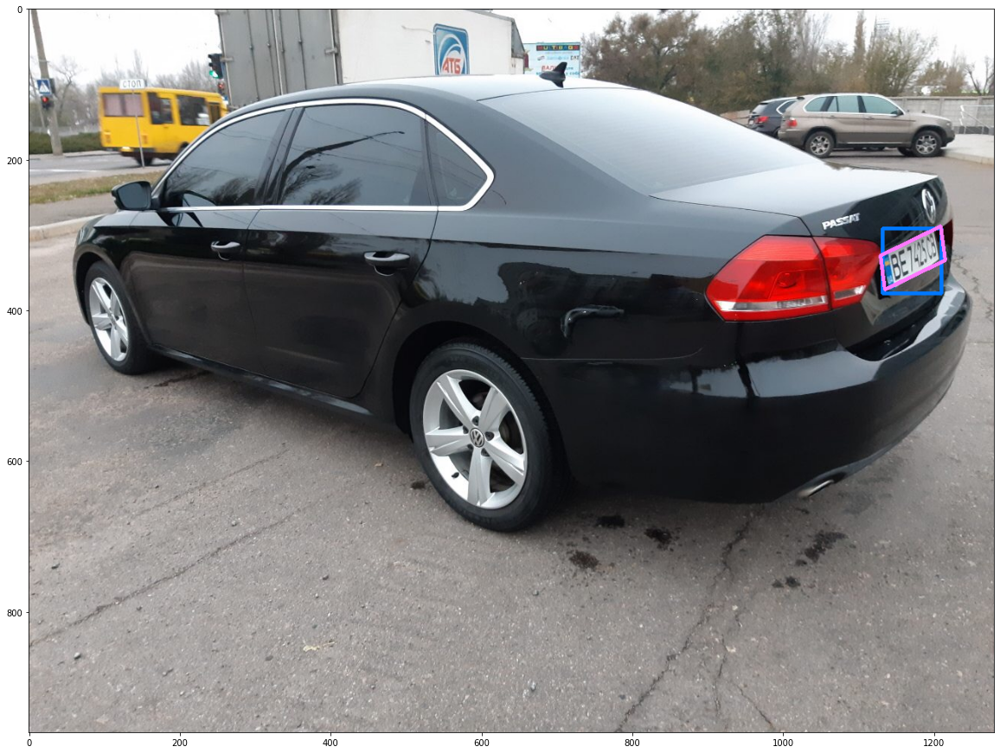

12.jpeg
__________ 		 ./images/12.jpeg 		 __________


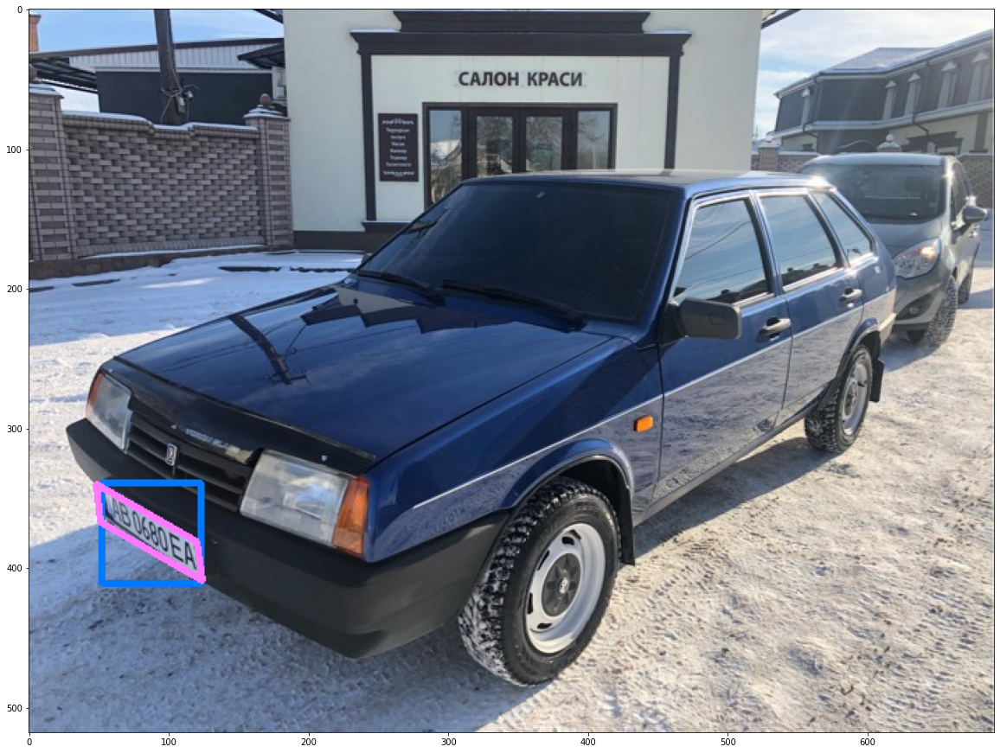

13.jpeg
__________ 		 ./images/13.jpeg 		 __________


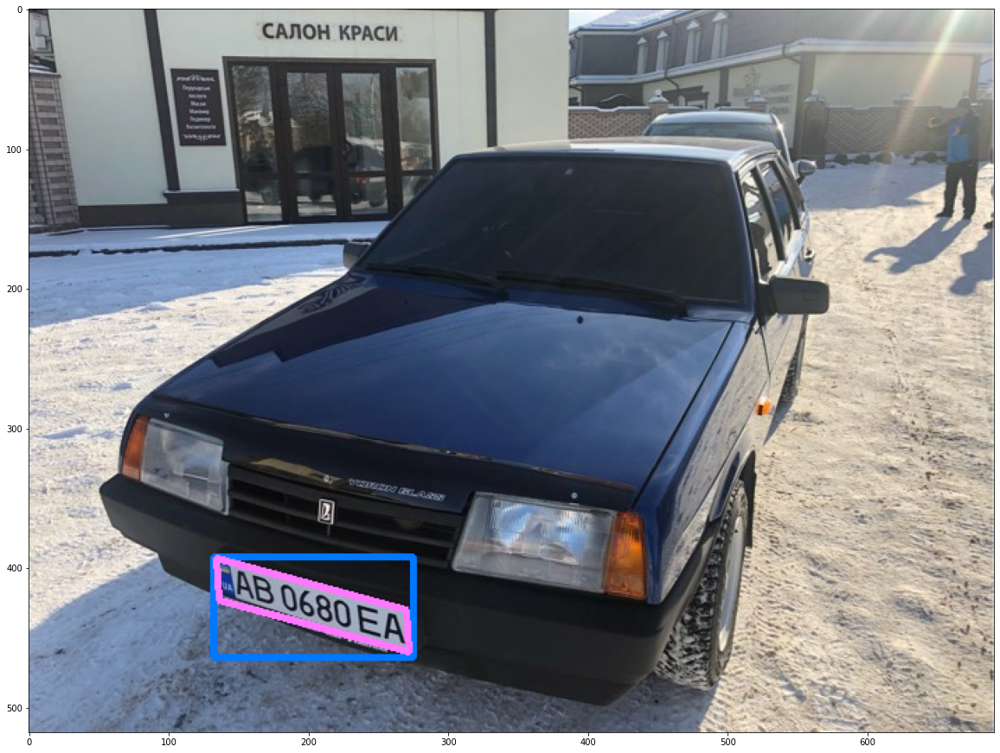

14.jpeg
__________ 		 ./images/14.jpeg 		 __________


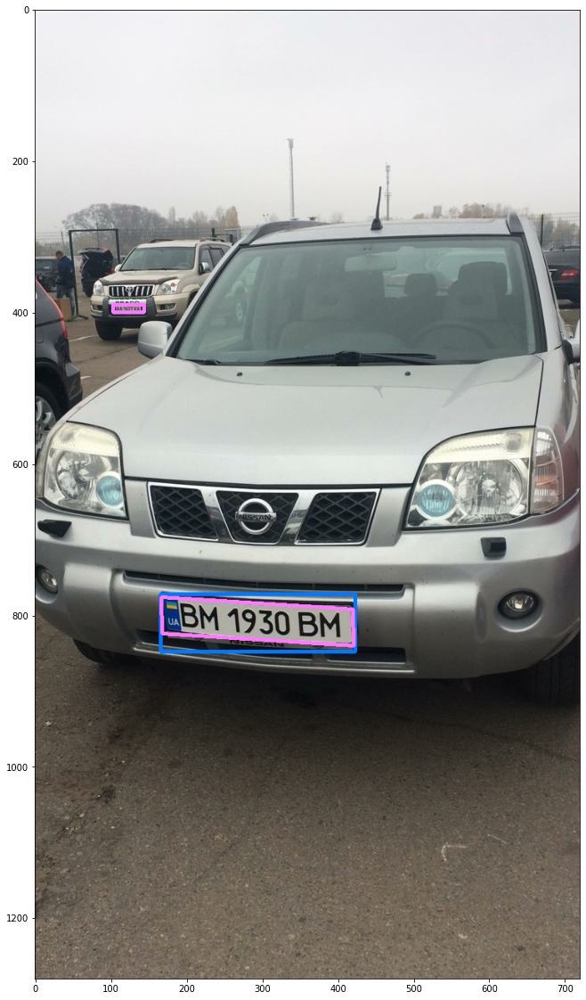

15.jpeg
__________ 		 ./images/15.jpeg 		 __________


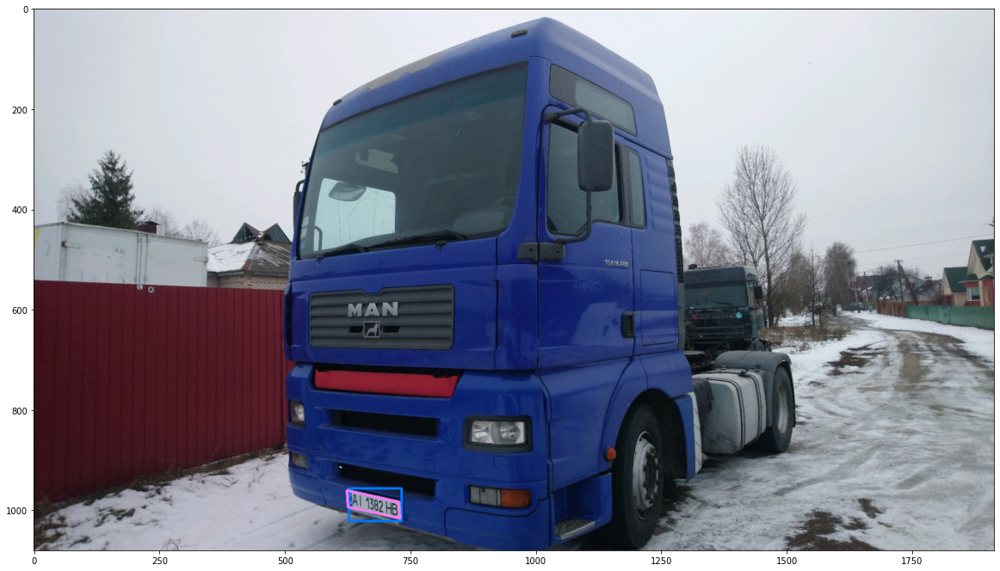

16.jpeg
__________ 		 ./images/16.jpeg 		 __________


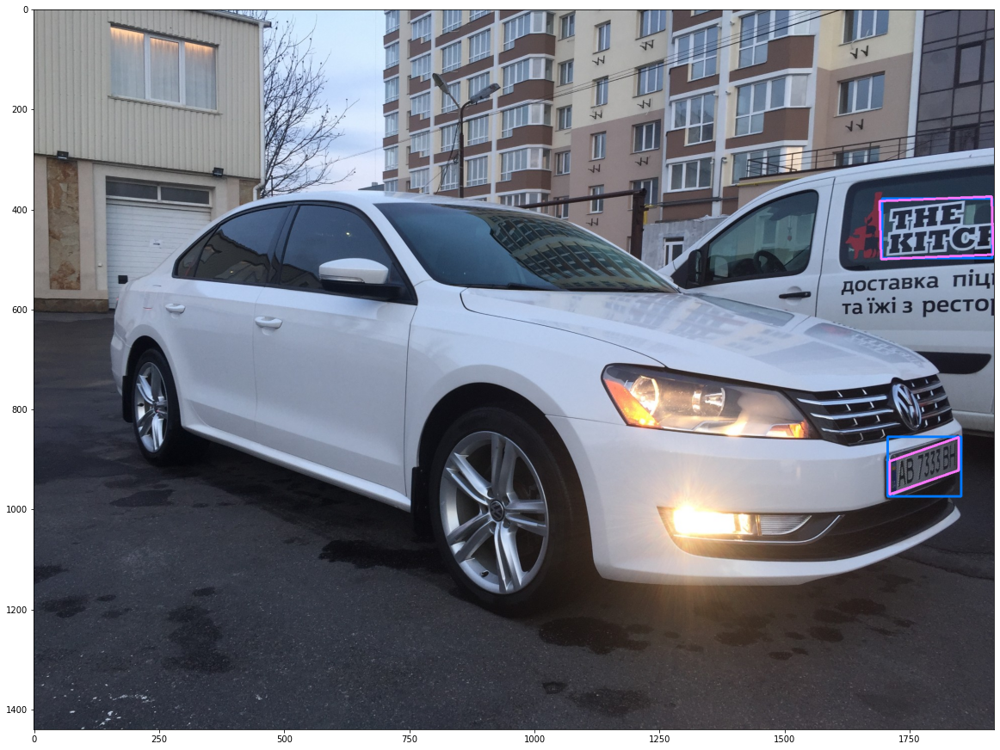

17.jpeg
__________ 		 ./images/17.jpeg 		 __________


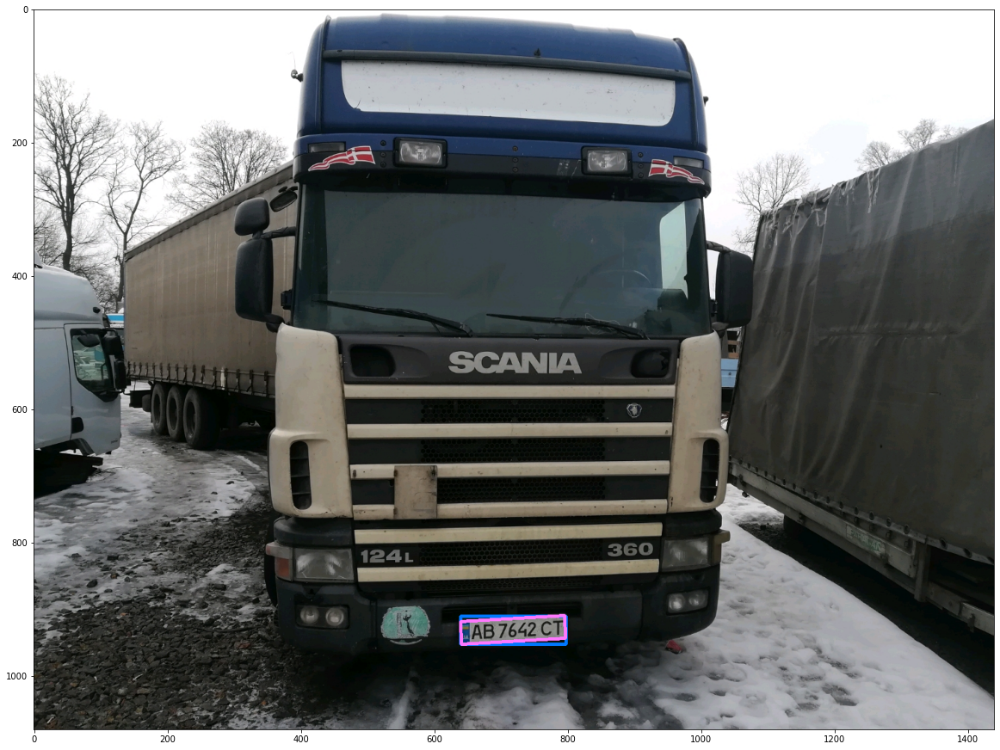

18.jpeg
__________ 		 ./images/18.jpeg 		 __________


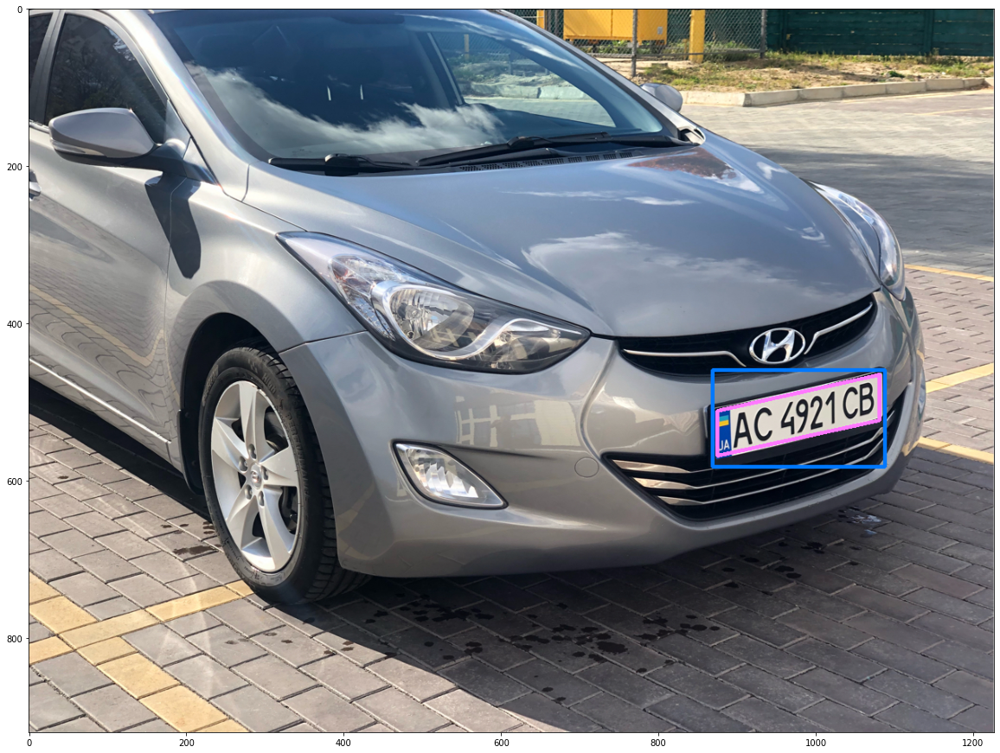

19.jpeg
__________ 		 ./images/19.jpeg 		 __________


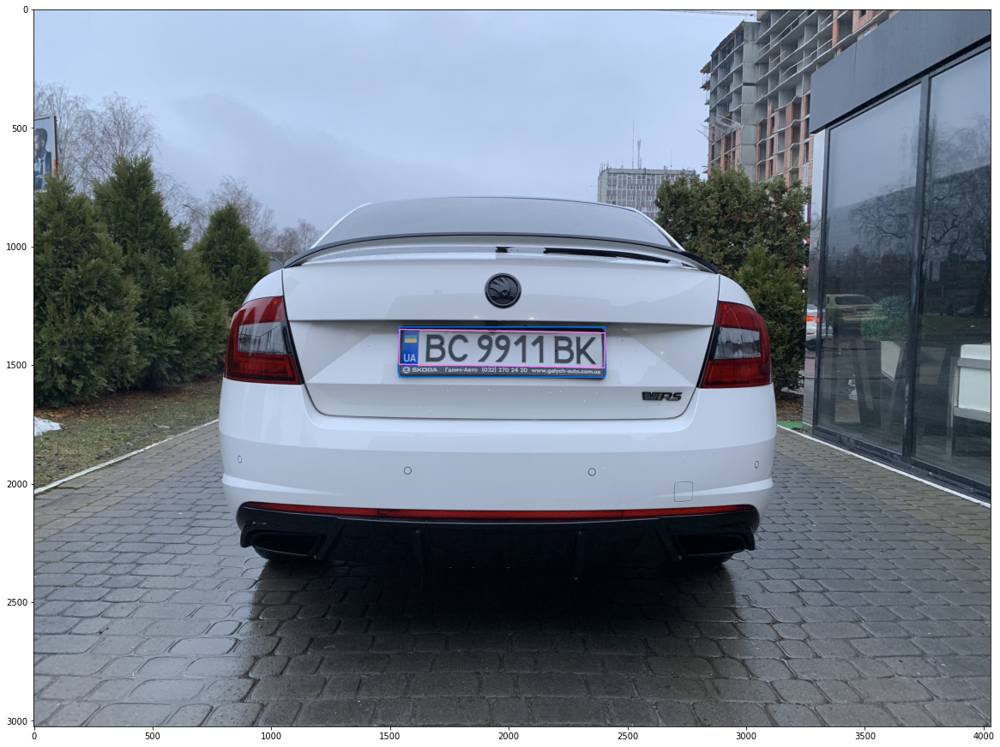

20.jpeg
__________ 		 ./images/20.jpeg 		 __________


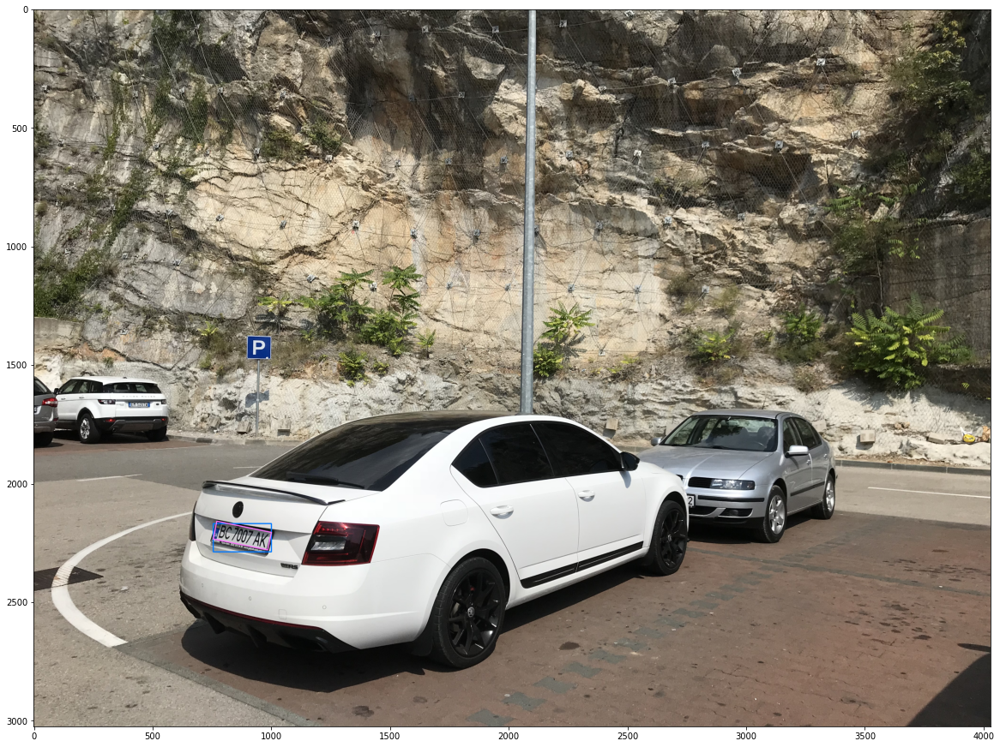

21.jpeg
__________ 		 ./images/21.jpeg 		 __________


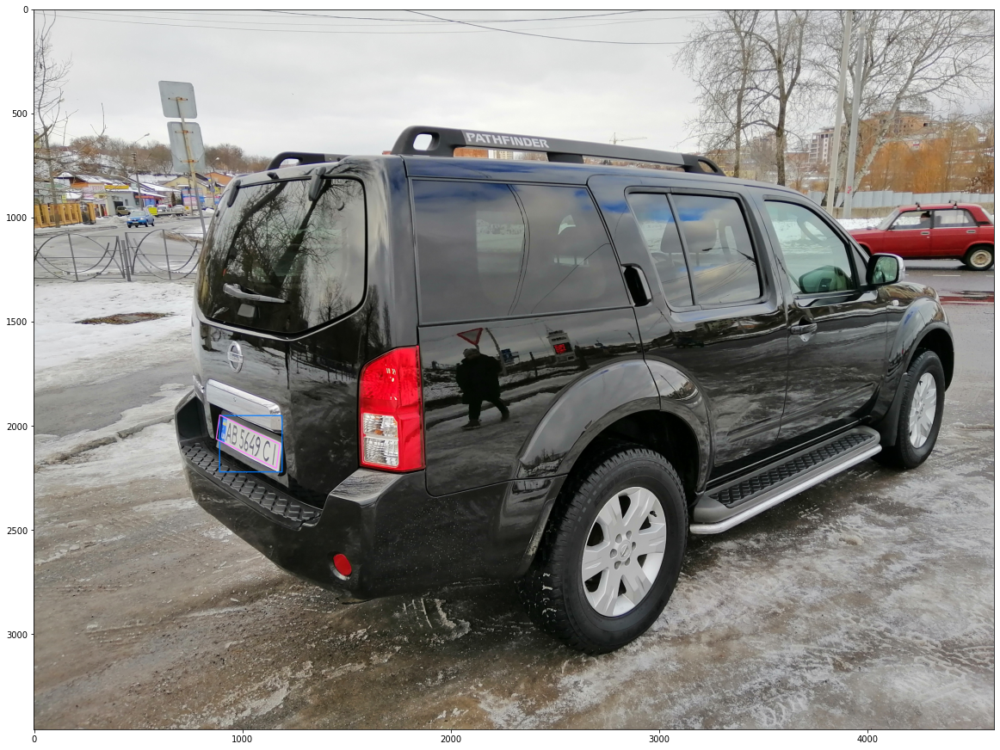

22.jpeg
__________ 		 ./images/22.jpeg 		 __________


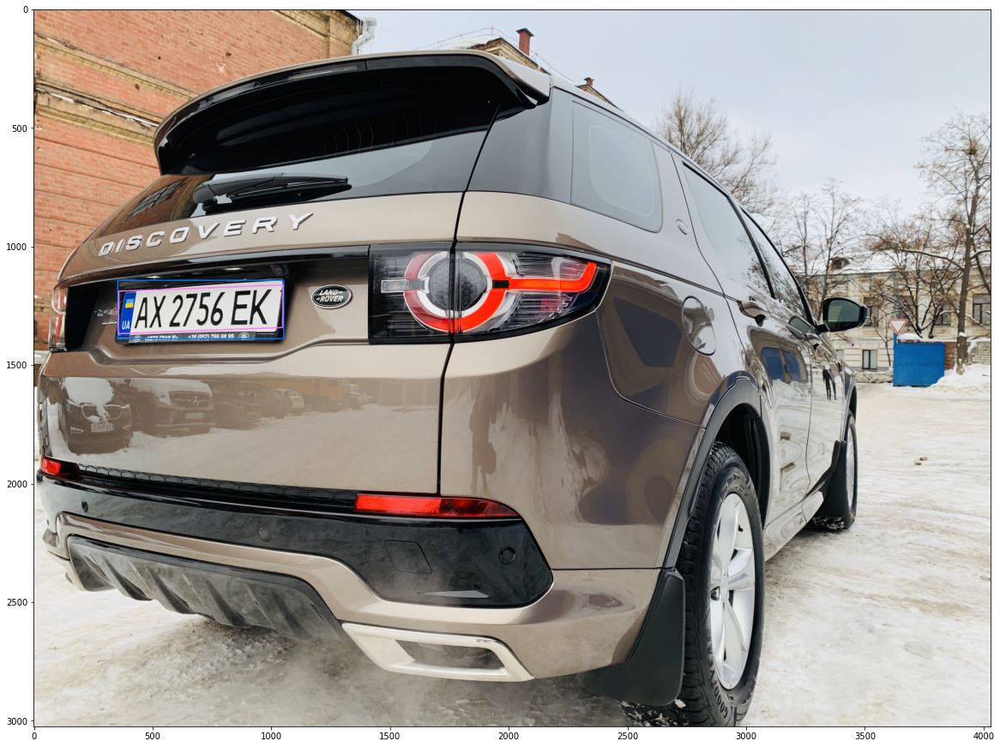

23.jpeg
__________ 		 ./images/23.jpeg 		 __________


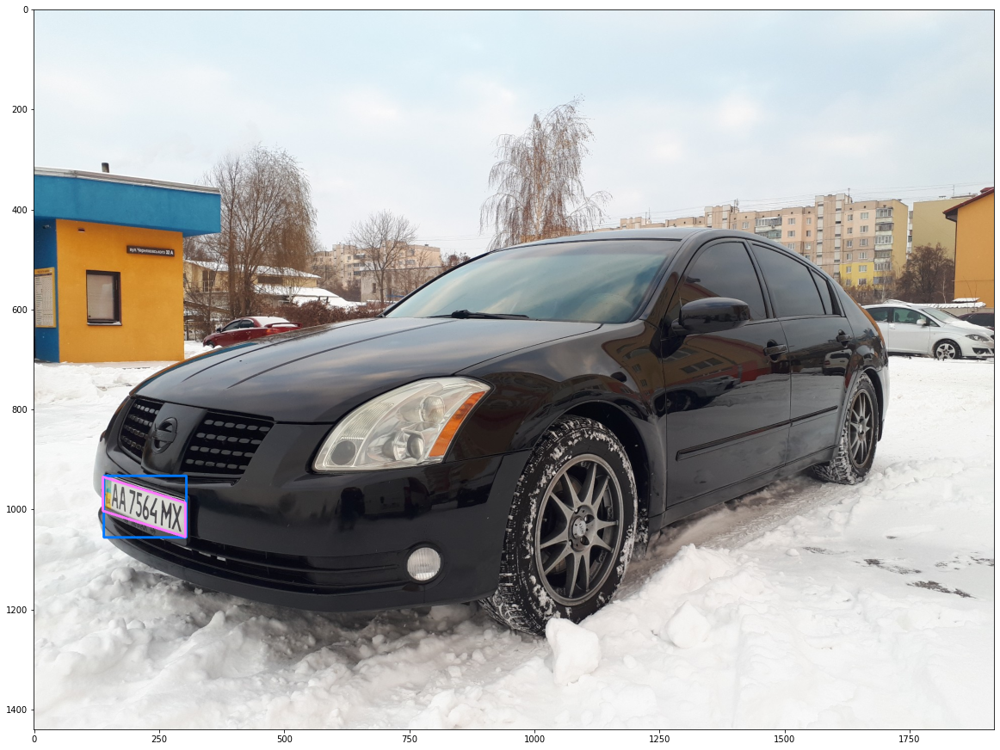

24.jpeg
__________ 		 ./images/24.jpeg 		 __________


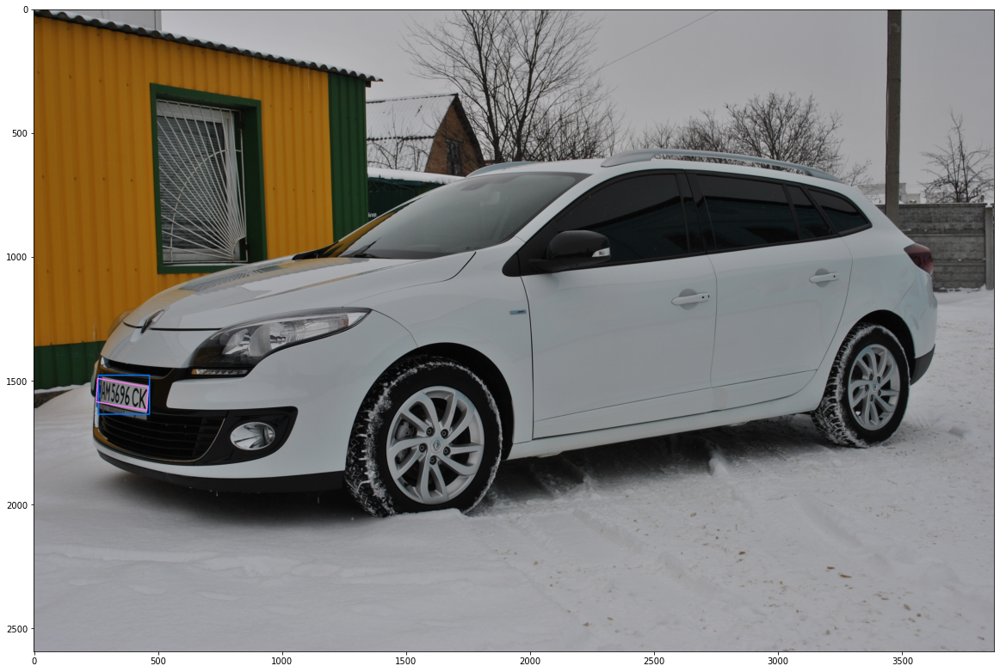

25.jpeg
__________ 		 ./images/25.jpeg 		 __________


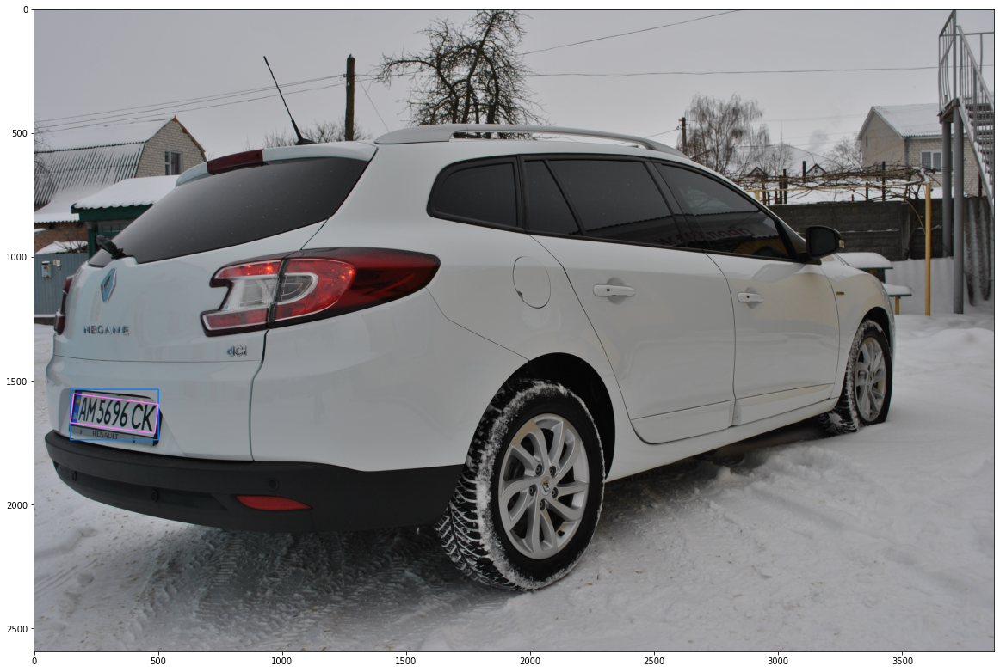

In [10]:
testData = {
    "0.jpeg": ["AI5255EI"],
    "1.jpeg": ["AT6883CM"],
    "2.jpeg": ["AT1515CK"],
    "3.jpeg": ["BX0578CE"],
    "4.jpeg": ["AC4249CB"],
    "5.jpeg": ["BC3496HC"],
    "6.jpeg": ["BC3496HC"],
    "7.jpeg": ["AO1306CH"],
    "8.jpeg": ["AE1077CO"],
    "9.jpeg": ["AB3391AK"],
    "10.jpeg": ["BE7425CB"],
    "11.jpeg": ["BE7425CB"],
    "12.jpeg": ["AB0680EA"],
    "13.jpeg": ["AB0680EA"],
    "14.jpeg": ["BM1930BM"],
    "15.jpeg": ["AI1382HB"],
    "16.jpeg": ["AB7333BH"],
    "17.jpeg": ["AB7642CT"],
    "18.jpeg": ["AC4921CB"],
    "19.jpeg": ["BC9911BK"],
    "20.jpeg": ["BC7007AK"],
    "21.jpeg": ["AB5649CI"],
    "22.jpeg": ["AX2756EK"],
    "23.jpeg": ["AA7564MX"],
    "24.jpeg": ["AM5696CK"],
    "25.jpeg": ["AM5696CK"],
}


%matplotlib inline
plt.rcParams["figure.figsize"]  = (20, 20)    


for fileName in testData.keys():
    print(fileName)
    await test(dirName, fileName, testData[fileName], verbose=1)